# Super-resolution using GANs

This Markdown consists of results of different GAN super resolution architectures. They are :
* Super-Resolution GAN (SRGAN)
* Enhanced Super-Resolution GAN (ESRGAN)
* SRGAN with Relativistic Discriminator(RaGAN)
* ESRGAN with Relativistic Discriminator(RaGAN)

Set up GPU and libraries

In [1]:
import os
from tensorflow.python.client import device_lib

os.environ["CUDA_DEVICE_ORDER"] = "PCI_BUS_ID"
os.environ["CUDA_VISIBLE_DEVICES"] = "0"
os.environ["TF_CPP_MIN_LOG_LEVEL"] = "2"
print(device_lib.list_local_devices())

[name: "/device:CPU:0"
device_type: "CPU"
memory_limit: 268435456
locality {
}
incarnation: 774931371606168163
, name: "/device:XLA_CPU:0"
device_type: "XLA_CPU"
memory_limit: 17179869184
locality {
}
incarnation: 8354593114945141482
physical_device_desc: "device: XLA_CPU device"
, name: "/device:XLA_GPU:0"
device_type: "XLA_GPU"
memory_limit: 17179869184
locality {
}
incarnation: 14300879883481700497
physical_device_desc: "device: XLA_GPU device"
, name: "/device:GPU:0"
device_type: "GPU"
memory_limit: 10573417677
locality {
  bus_id: 1
  links {
  }
}
incarnation: 10234186463201241398
physical_device_desc: "device: 0, name: GeForce GTX 1080 Ti, pci bus id: 0000:01:00.0, compute capability: 6.1"
]


In [2]:
from glob import glob
import re
import cv2
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from skimage.metrics import structural_similarity as ssim
from skimage.metrics import peak_signal_noise_ratio as psnr

In /home/deeplearning/.local/lib/python3.6/site-packages/matplotlib/mpl-data/stylelib/_classic_test.mplstyle: 
The text.latex.unicode rcparam was deprecated in Matplotlib 3.0 and will be removed in 3.2.
In /home/deeplearning/.local/lib/python3.6/site-packages/matplotlib/mpl-data/stylelib/_classic_test.mplstyle: 
The savefig.frameon rcparam was deprecated in Matplotlib 3.1 and will be removed in 3.3.
In /home/deeplearning/.local/lib/python3.6/site-packages/matplotlib/mpl-data/stylelib/_classic_test.mplstyle: 
The pgf.debug rcparam was deprecated in Matplotlib 3.0 and will be removed in 3.2.
In /home/deeplearning/.local/lib/python3.6/site-packages/matplotlib/mpl-data/stylelib/_classic_test.mplstyle: 
The verbose.level rcparam was deprecated in Matplotlib 3.1 and will be removed in 3.3.
In /home/deeplearning/.local/lib/python3.6/site-packages/matplotlib/mpl-data/stylelib/_classic_test.mplstyle: 
The verbose.fileo rcparam was deprecated in Matplotlib 3.1 and will be removed in 3.3.


Import generator models from the GAN architectures.

In [3]:
from ESRGAN.ESRGAN import build_generator as esrgan_gen
from SRGAN.SRGAN import build_generator as srgan_gen
from ESRGAN_rel.ESRGAN import build_generator as esrgan_ragan_gen
from SRGAN_rel.SRGAN import build_generator as srgan_ragan_gen


Using TensorFlow backend.


In [4]:
#Create a ESRGAN generator and load weights
esrgan_G = esrgan_gen(2) # 2 is the upscale factor.
esrgan_G.load_weights('ESRGAN/generator_subpixel_2000.h5')

Instructions for updating:
If using Keras pass *_constraint arguments to layers.


In [5]:
#Create a ESRGAN generator and load weights
esrgan_ragan_G = esrgan_gen(2) # 2 is the upscale factor.
esrgan_ragan_G.load_weights('ESRGAN_rel/generator_subpixel_1000.h5')

In [6]:
#Create a SRGAN generator and load weights
srgan_G = srgan_gen([None,None, 3],2) # None,None,3 is the shape of input and 2 is the upscale factor.
srgan_G.load_weights('SRGAN/generator_subpixel_2000.h5')

In [7]:
#Create a SRGAN generator and load weights
srgan_ragan_G = srgan_gen([None,None, 3],2) # None,None,3 is the shape of input and 2 is the upscale factor.
srgan_ragan_G.load_weights('SRGAN_rel/generator_subpixel_2000.h5')

In [8]:
#Load DIV2K bicubic downscaled(2x) images.
dir_path         = './DIV2K/DIV2K_test_LR_bicubic/X2/'

img_list, img_low_list = [], []
for img_path in glob(dir_path + '/*.png'):
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img_hr = cv2.resize(img, (256, 256),interpolation=cv2.INTER_CUBIC)
    img_list.append(img_hr)
    img_low_list.append(cv2.resize(img_hr, (128, 128)))

    high_reso_imgs = np.array(img_list)
    low_reso_imgs = np.array(img_low_list)
  

Define function for plotting the actual HR image, BiCubic downsampled image and the GAN generated HR image.

In [9]:
def plot_div2k_op(G,name):
    n_imgs=4
    plt.figure(figsize=(12, 12))
    plt.tight_layout()
    for i in range(0, n_imgs * 3, 3):
        idx = np.random.randint(0, low_reso_imgs.shape[0] - 1)
        plt.subplot(n_imgs, 3, i + 1)
        ssim_hr = ssim(high_reso_imgs[idx], high_reso_imgs[idx],multichannel=True)
        psnr_hr = psnr(high_reso_imgs[idx],high_reso_imgs[idx])
        plt.imshow(high_reso_imgs[idx])
        plt.grid('off')
        plt.axis('off')
        plt.title('Source (PSNR :{:.2f} ,SSIM:{:.2f})'.format(psnr_hr,ssim_hr))
        plt.subplot(n_imgs, 3, i + 2)
        low_res = cv2.resize(low_reso_imgs[idx], (256, 256))
        ssim_lr = ssim(high_reso_imgs[idx], low_res,multichannel=True)
        psnr_lr = psnr(high_reso_imgs[idx],low_res)
        
        plt.imshow(low_res)
        plt.grid('off')
        plt.axis('off')
        plt.title('X2 (PSNR :{:.2f} ,SSIM:{:.2f})'.format(psnr_lr,ssim_lr))

        img = G.predict(np.expand_dims(low_reso_imgs[idx], axis=0) / 127.5 - 1)
        img_unnorm = (img + 1) * 127.5
        img_gan = np.squeeze(img_unnorm, axis=0).astype(np.uint8)
        ssim_gan = ssim(high_reso_imgs[idx], img_gan,multichannel=True)
        psnr_gan = psnr(high_reso_imgs[idx],img_gan)
        plt.subplot(n_imgs, 3, i + 3)
        plt.imshow(img_gan)
        
    
        plt.grid('off')
        plt.axis('off')
        plt.title(name+ '(PSNR :{:.2f} ,SSIM:{:.2f})'.format(psnr_gan,ssim_gan))

## ESRGAN results

/home/deeplearning/.local/lib/python3.6/site-packages/skimage/metrics/simple_metrics.py:160: RuntimeWarning: divide by zero encountered in double_scalars
  return 10 * np.log10((data_range ** 2) / err)


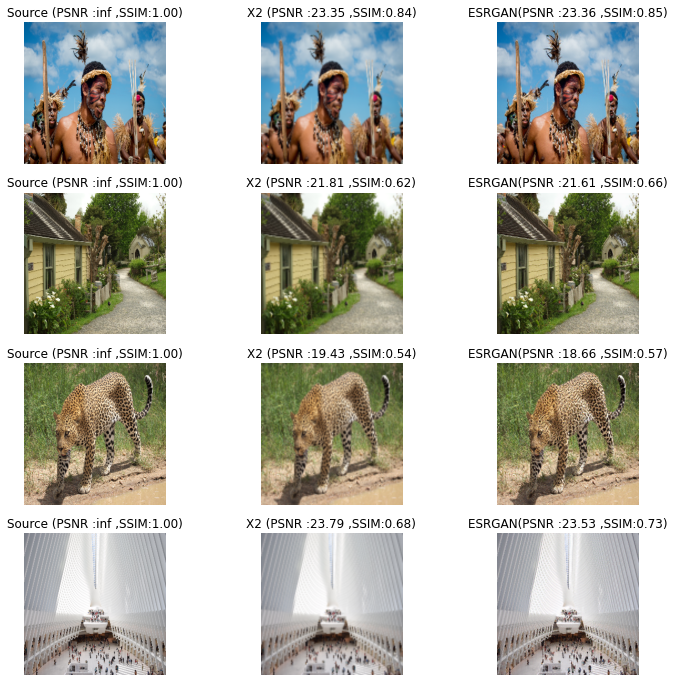

In [10]:
plot_div2k_op(esrgan_G,'ESRGAN')

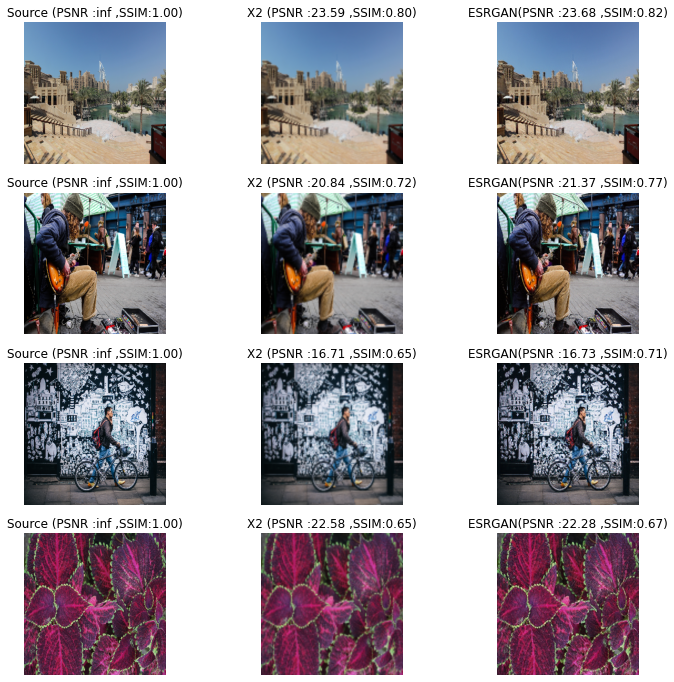

In [11]:
plot_div2k_op(esrgan_G,'ESRGAN')

## SRGAN results 

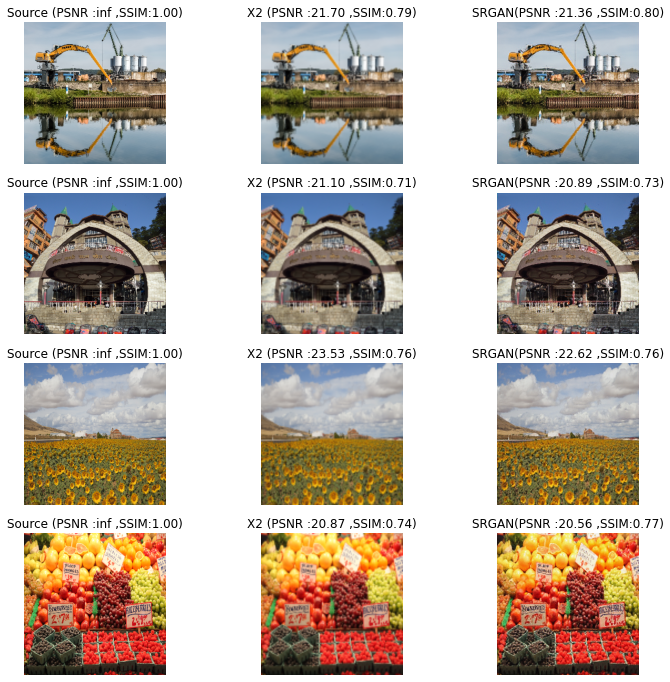

In [12]:
plot_div2k_op(srgan_G,'SRGAN')

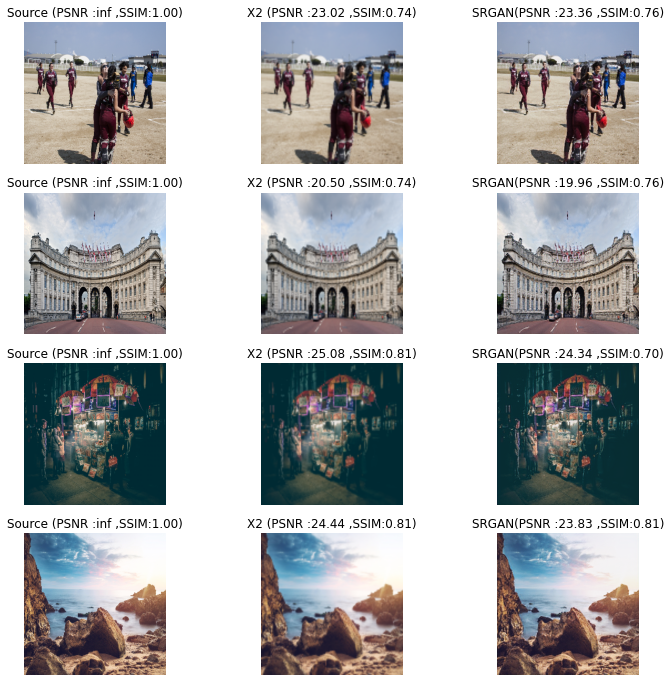

In [13]:
plot_div2k_op(srgan_G,'SRGAN')

## ESRGAN with relative discriminator results 

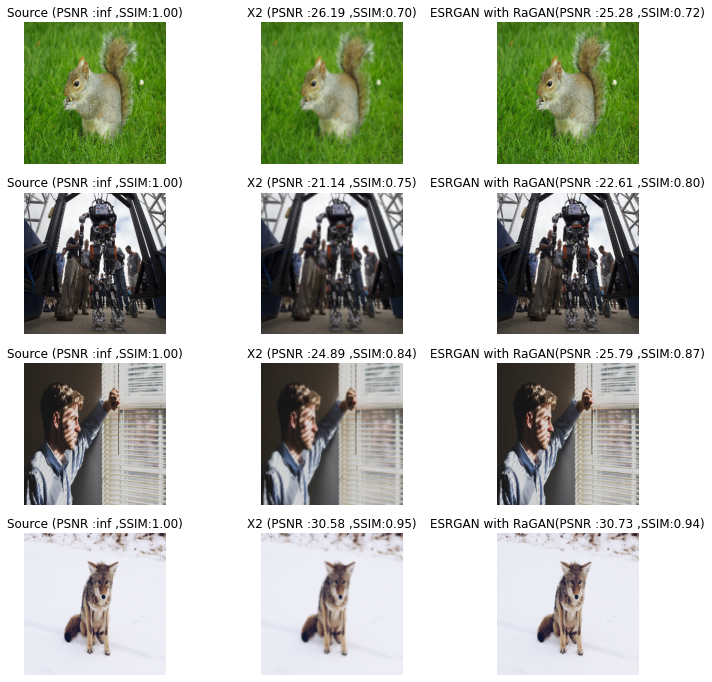

In [14]:
plot_div2k_op(esrgan_ragan_G,'ESRGAN with RaGAN')

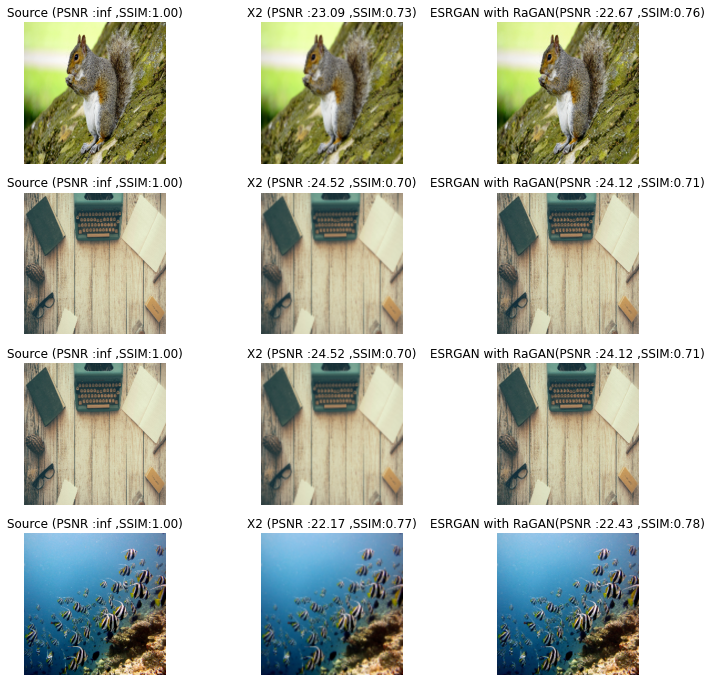

In [15]:
plot_div2k_op(esrgan_ragan_G,'ESRGAN with RaGAN')

## SRGAN with relative discriminator results 

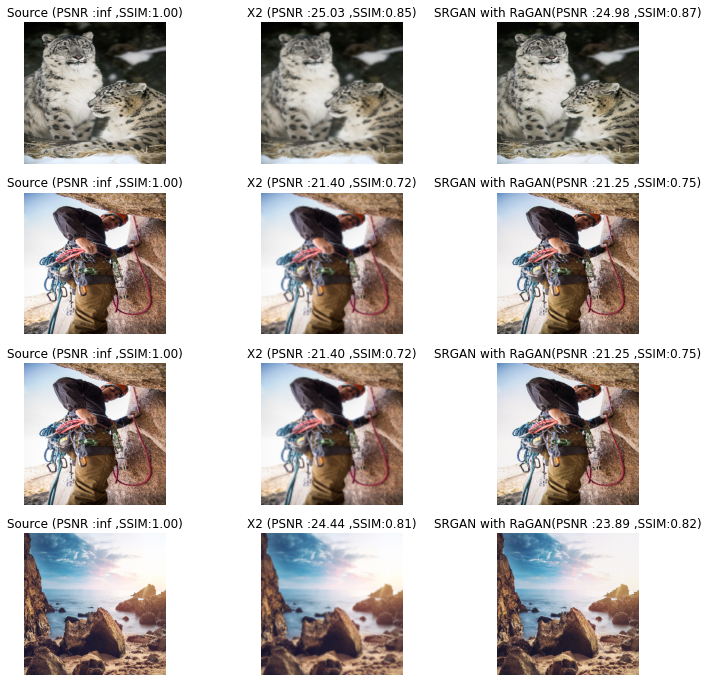

In [16]:
plot_div2k_op(srgan_ragan_G,'SRGAN with RaGAN')

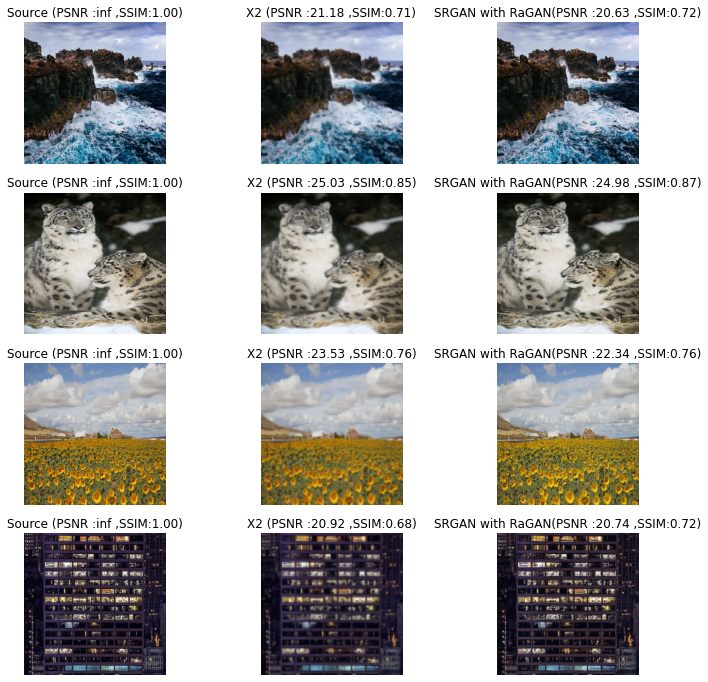

In [17]:
plot_div2k_op(srgan_ragan_G,'SRGAN with RaGAN')

Define a function to plot the HR image, BiCubic downscaled image and the GAN generated image. Then add a function to take a random crop and provide results of the image zoomed.

In [18]:
def get_random_crop(image, crop_height, crop_width):

    max_x = image.shape[1] - crop_width
    max_y = image.shape[0] - crop_height

    x = np.random.randint(0, max_x)
    y = np.random.randint(0, max_y)

    crop = image[y: y + crop_height, x: x + crop_width]

    return crop,x,y

In [19]:
def plot_div2k_zoom(G,name):
    crop_height = 96
    crop_width = 96
    fig = plt.figure(figsize=(12, 12))
    fig.set_tight_layout({"pad": .0})

    idx = np.random.randint(0, low_reso_imgs.shape[0] - 1)
    img_hrp,x,y = get_random_crop(high_reso_imgs[idx], crop_height, crop_width)

    img_tmp = cv2.resize(low_reso_imgs[idx], (256, 256))

    rect = patches.Rectangle((x,y),crop_height,crop_width,linewidth=1,edgecolor='r',facecolor='none')
    rect1 = patches.Rectangle((x,y),crop_height,crop_width,linewidth=1,edgecolor='r',facecolor='none')
    rect2 = patches.Rectangle((x,y),crop_height,crop_width,linewidth=1,edgecolor='r',facecolor='none')

    ax1  = fig.add_subplot(2, 3, 1)
    ax1.add_patch(rect)
    plt.imshow(high_reso_imgs[idx])
    plt.grid('off')
    plt.axis('off')
    plt.title('Source')


    ax4  = fig.add_subplot(2, 3, 4)
    plt.imshow(img_hrp)
    plt.grid('off')
    plt.axis('off')
    plt.title('Source')

    ax2  = fig.add_subplot(2, 3, 2)

    plt.imshow(img_tmp)
    ax2.add_patch(rect1)
    plt.grid('off')
    plt.axis('off')
    plt.title('X2 (bicubic)')

    ax5  = fig.add_subplot(2, 3, 5)
    plt.imshow(img_tmp[y: y + crop_height, x: x + crop_width])
    plt.grid('off')
    plt.axis('off')
    plt.title('X2 (bicubic)')

    img = G.predict(np.expand_dims(low_reso_imgs[idx], axis=0) / 127.5 - 1)
    img_unnorm = (img + 1) * 127.5
    ax3  = fig.add_subplot(2, 3, 3)
    ax3.add_patch(rect2)
    img_gan = np.squeeze(img_unnorm, axis=0).astype(np.uint8)
    plt.imshow(img_gan)
    plt.grid('off')
    plt.axis('off')
    plt.title(name)


    ax6  = fig.add_subplot(2, 3, 6)
    plt.imshow(img_gan[y: y + crop_height, x: x + crop_width])
    plt.grid('off')
    plt.axis('off')
    plt.title(name)

## SRGAN result zoomed

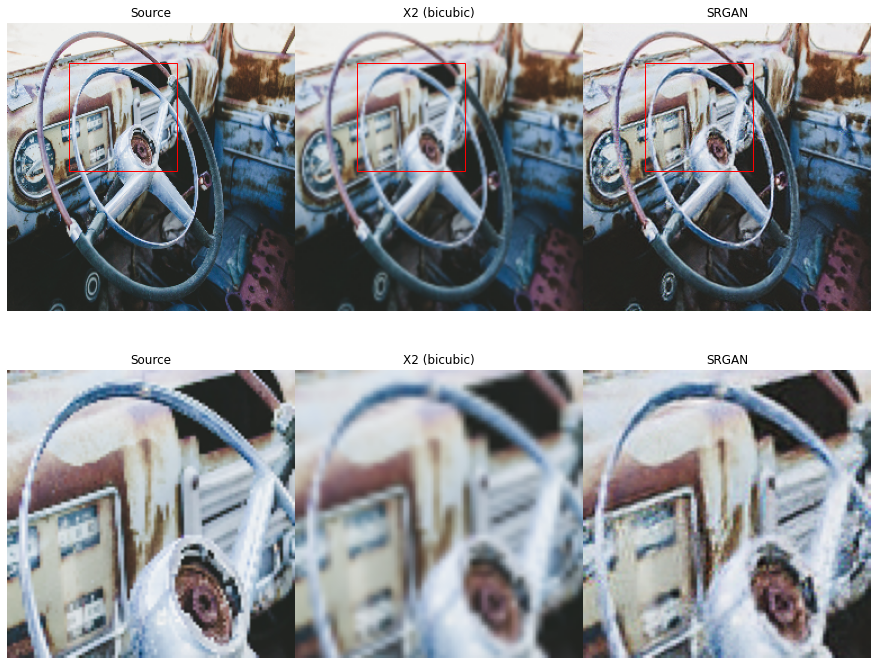

In [20]:
plot_div2k_zoom(srgan_G,'SRGAN')

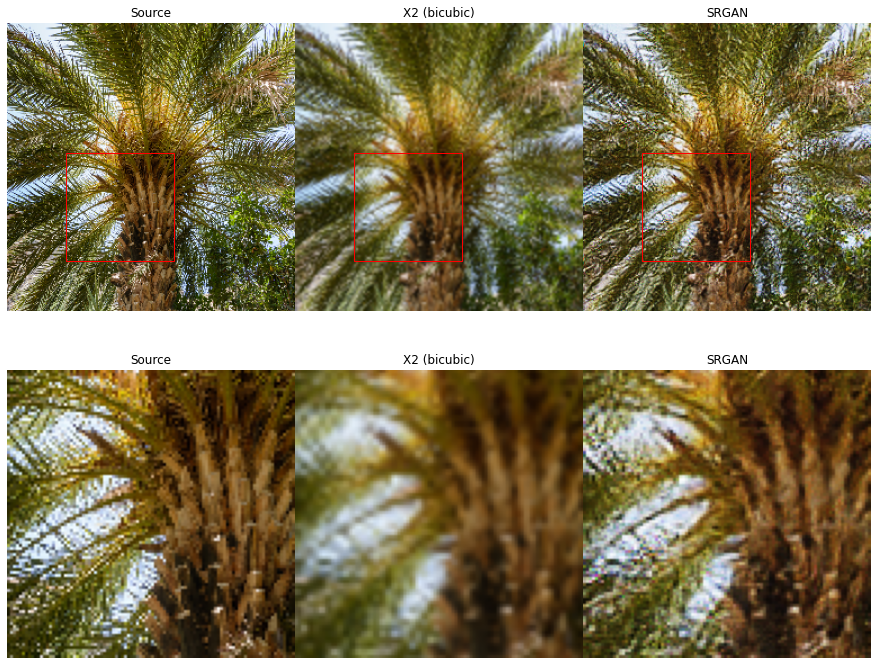

In [21]:
plot_div2k_zoom(srgan_G,'SRGAN')

## ESRGAN result zoomed

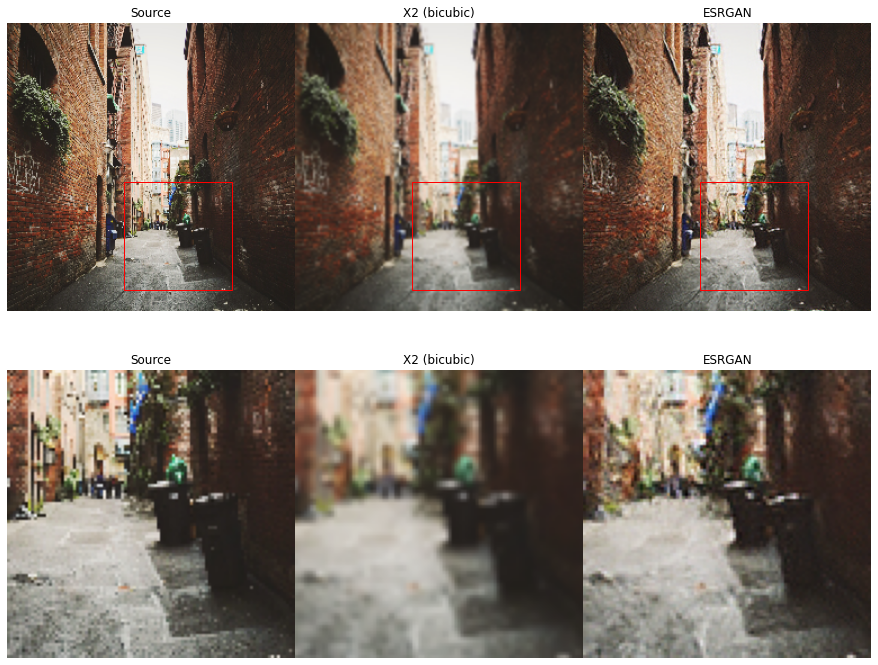

In [22]:
plot_div2k_zoom(esrgan_G,'ESRGAN')

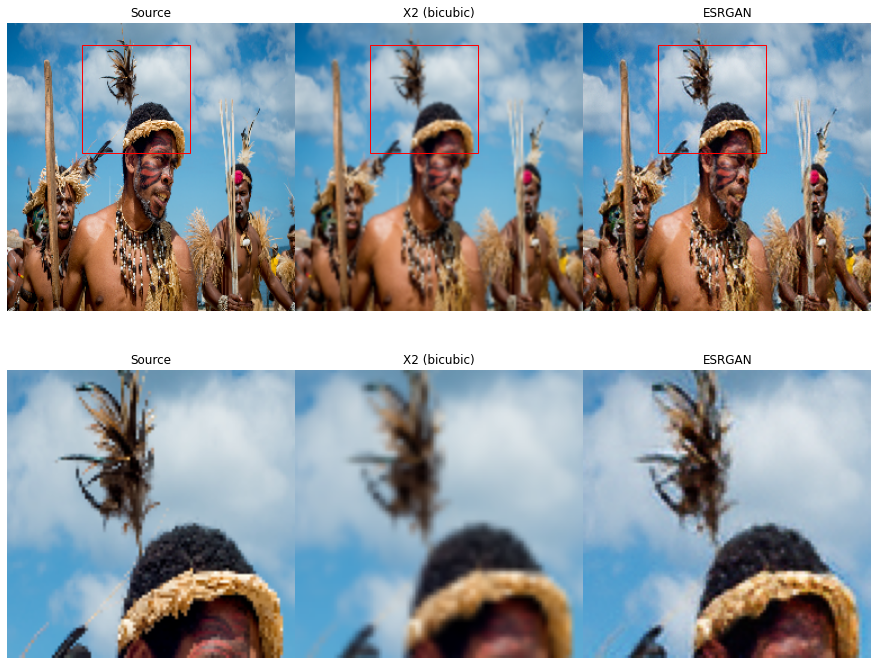

In [23]:
plot_div2k_zoom(esrgan_G,'ESRGAN')

## ESRGAN with relative discriminator zoomed 

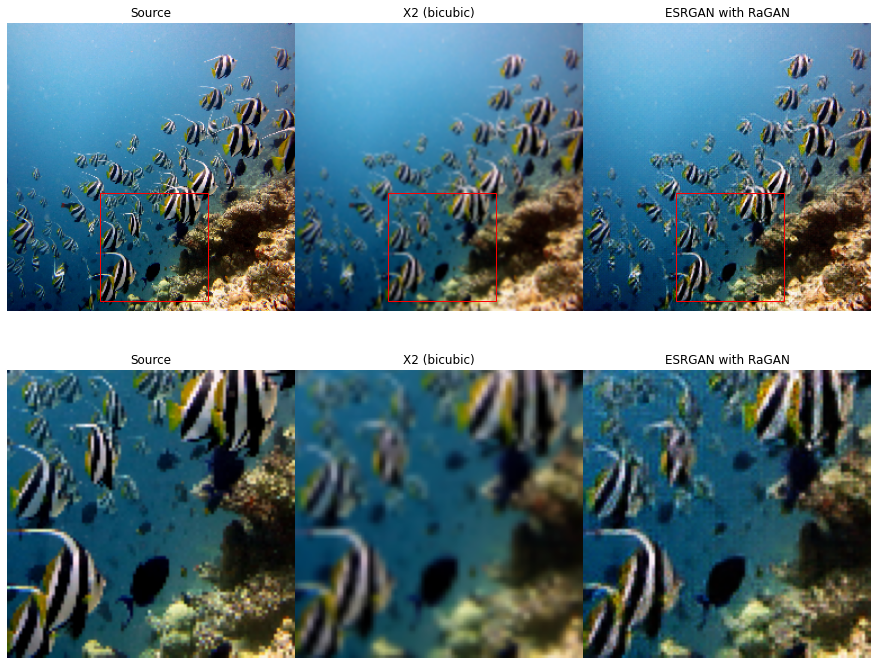

In [24]:
plot_div2k_zoom(esrgan_ragan_G,'ESRGAN with RaGAN')

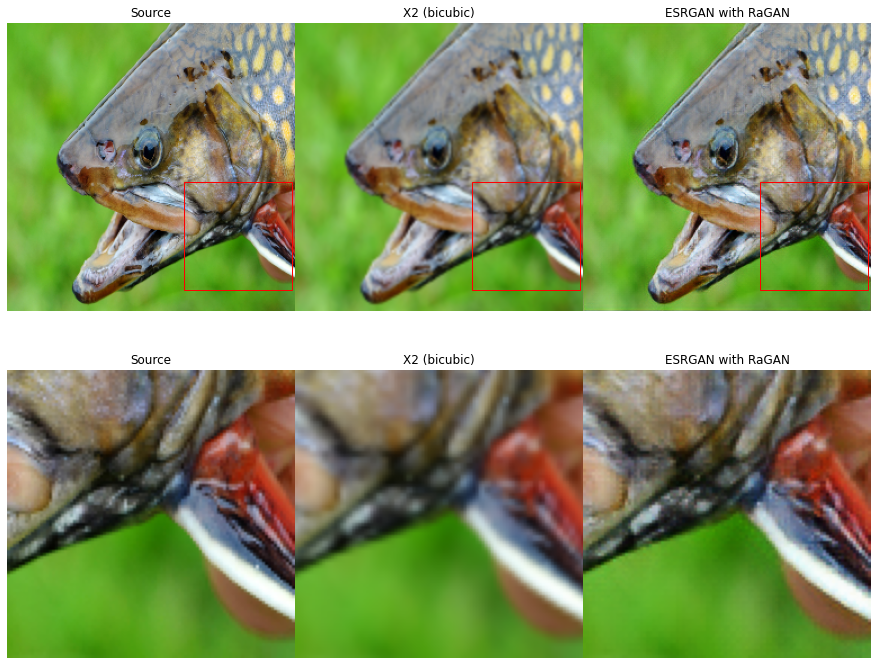

In [25]:
plot_div2k_zoom(esrgan_ragan_G,'ESRGAN with RaGAN')

## SRGAN with relative discriminator zoomed 

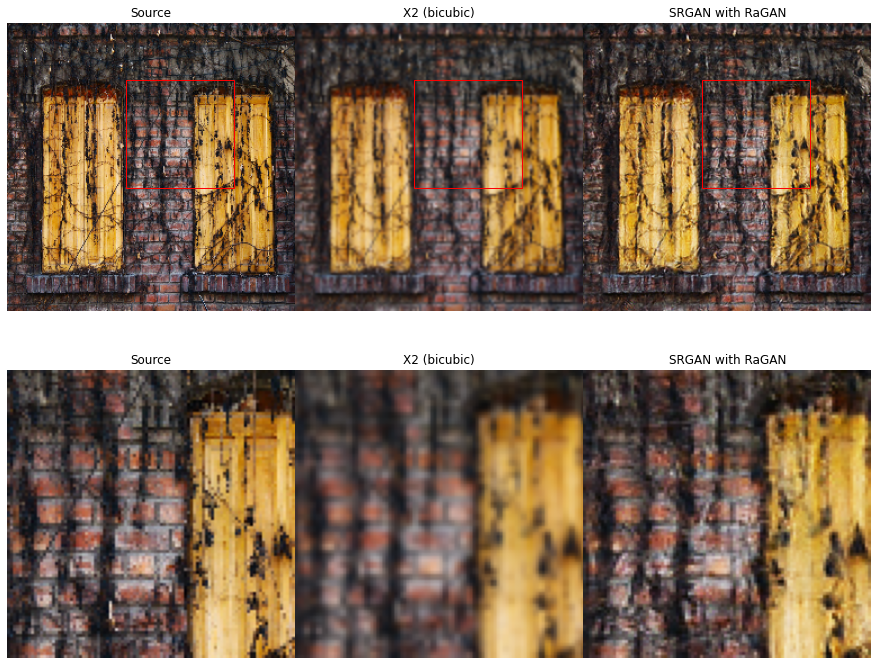

In [26]:
plot_div2k_zoom(srgan_ragan_G,'SRGAN with RaGAN')

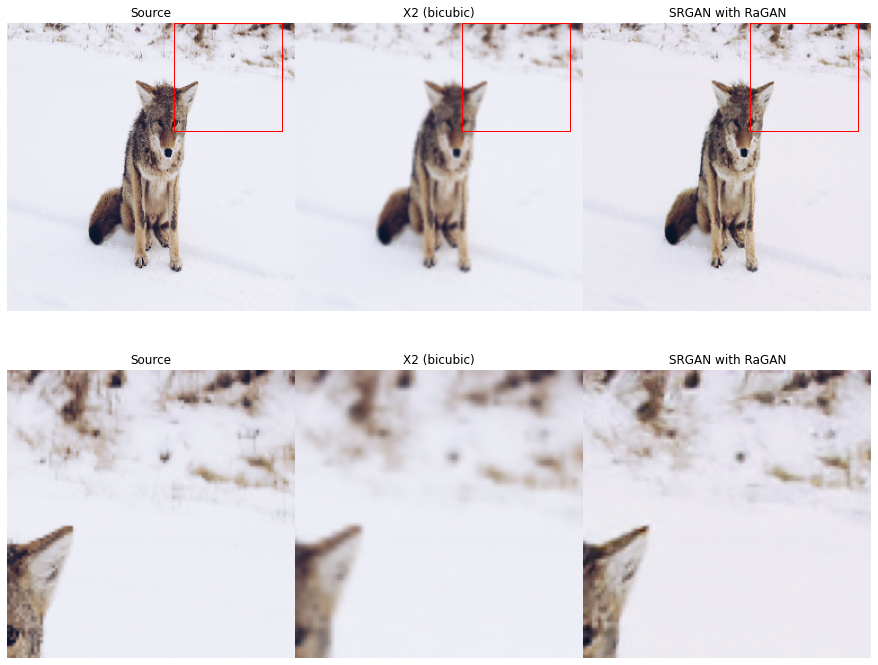

In [27]:
plot_div2k_zoom(srgan_ragan_G,'SRGAN with RaGAN')

Define function to plot HR image, BiCubic downsampled image and GAN generated images of SRGAN and ESRGAN.

In [28]:
def plot_gan_comp(G1,G2,G1_name,G2_name):
    n_imgs=4
    plt.figure(figsize=(18, 18))
    plt.tight_layout()
    for i in range(0, n_imgs * 4, 4):
        idx = np.random.randint(0, low_reso_imgs.shape[0] - 1)
        plt.subplot(n_imgs, 4, i + 1)
        plt.imshow(high_reso_imgs[idx])
        plt.grid('off')
        plt.axis('off')
        plt.title('Source')
        plt.subplot(n_imgs, 4, i + 2)
        plt.imshow(cv2.resize(low_reso_imgs[idx], (256, 256)))
        plt.grid('off')
        plt.axis('off')
        plt.title('X2 (bicubic)')

        img = G1.predict(np.expand_dims(low_reso_imgs[idx], axis=0) / 127.5 - 1)
        img_unnorm = (img + 1) * 127.5
        plt.subplot(n_imgs, 4, i + 3)
        plt.imshow(np.squeeze(img_unnorm, axis=0).astype(np.uint8))        
    
        plt.grid('off')
        plt.axis('off')
        plt.title(G1_name)
        
        img = G2.predict(np.expand_dims(low_reso_imgs[idx], axis=0) / 127.5 - 1)
        img_unnorm = (img + 1) * 127.5
        plt.subplot(n_imgs, 4, i + 4)
        plt.imshow(np.squeeze(img_unnorm, axis=0).astype(np.uint8))        
    
        plt.grid('off')
        plt.axis('off')
        plt.title(G2_name)

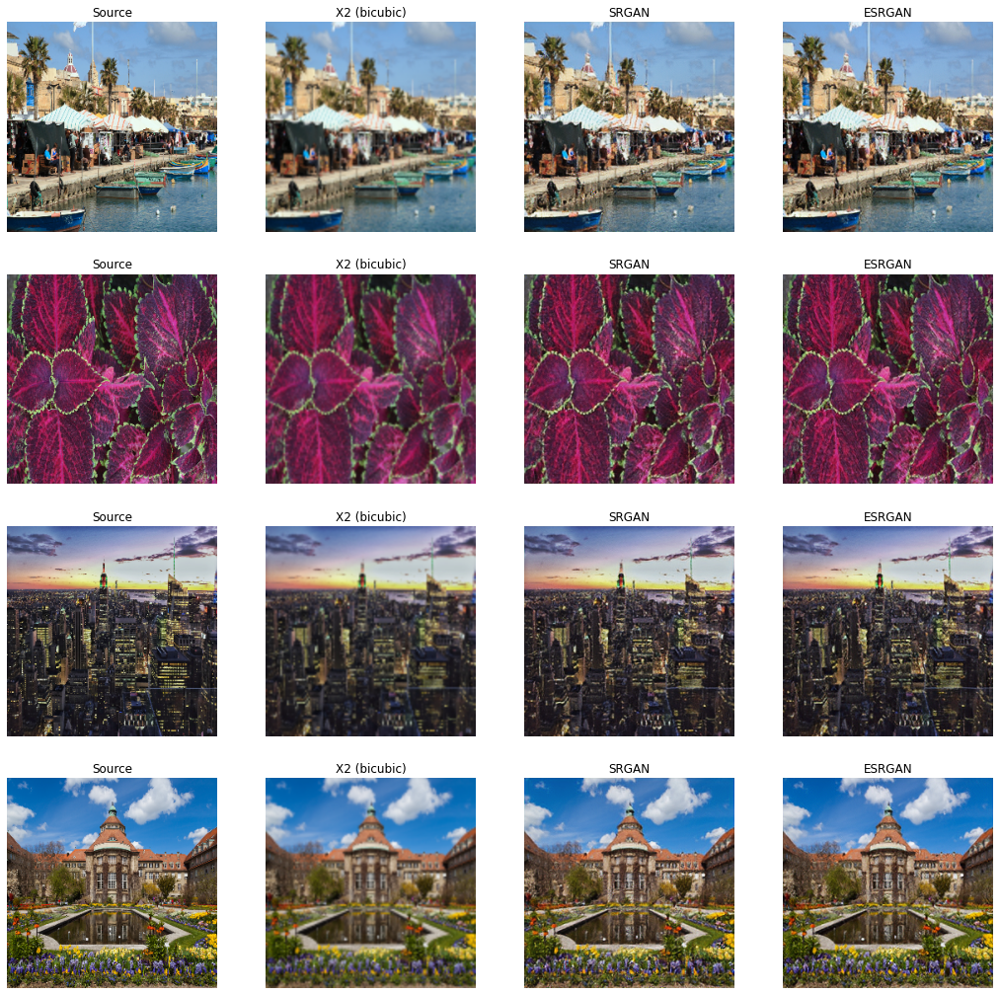

In [29]:
plot_gan_comp(srgan_G,esrgan_G,'SRGAN','ESRGAN')

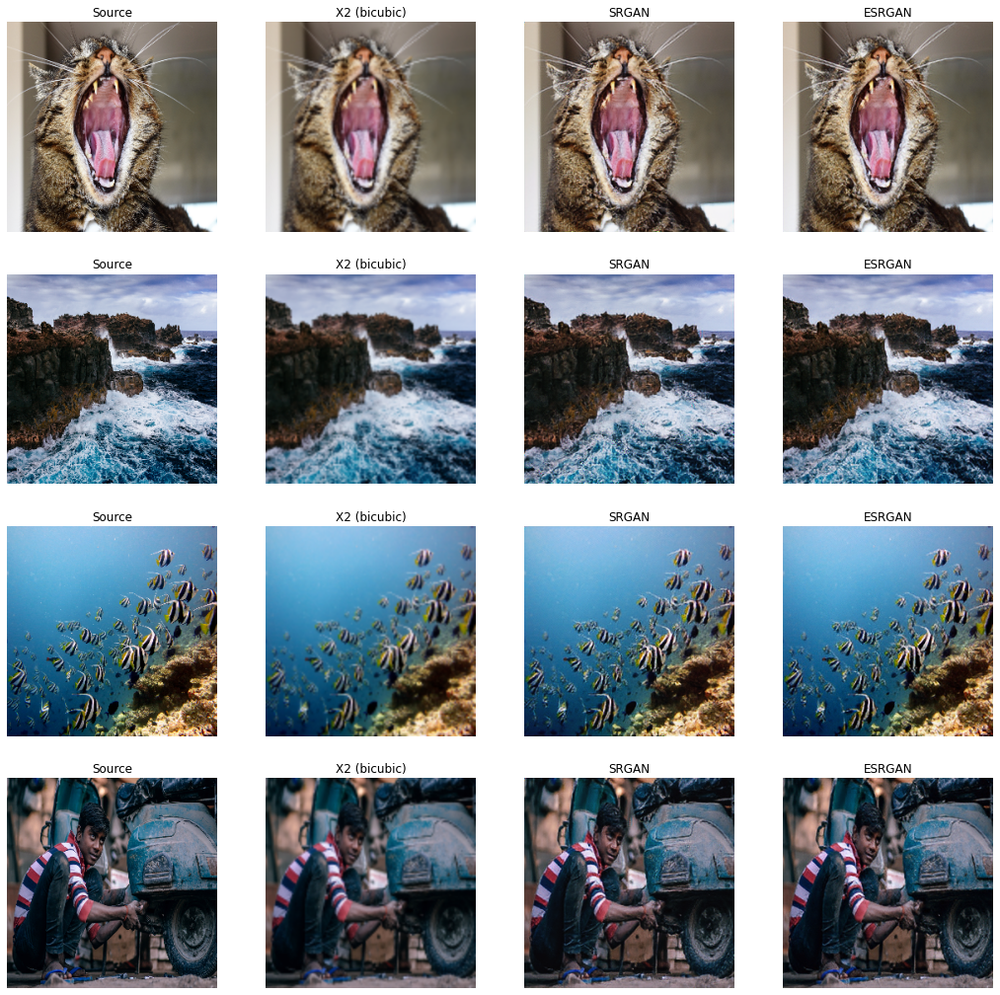

In [30]:
plot_gan_comp(srgan_G,esrgan_G,'SRGAN','ESRGAN')

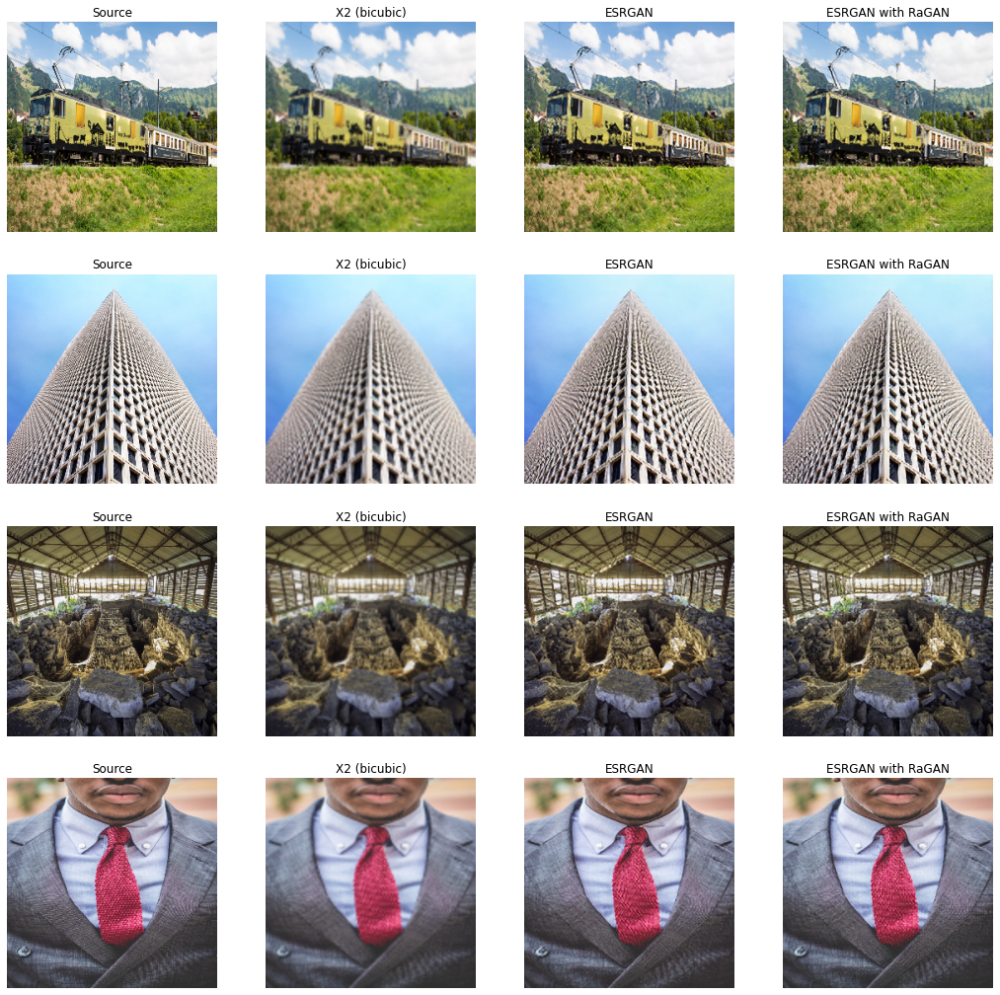

In [31]:
plot_gan_comp(esrgan_G,esrgan_ragan_G,'ESRGAN','ESRGAN with RaGAN')

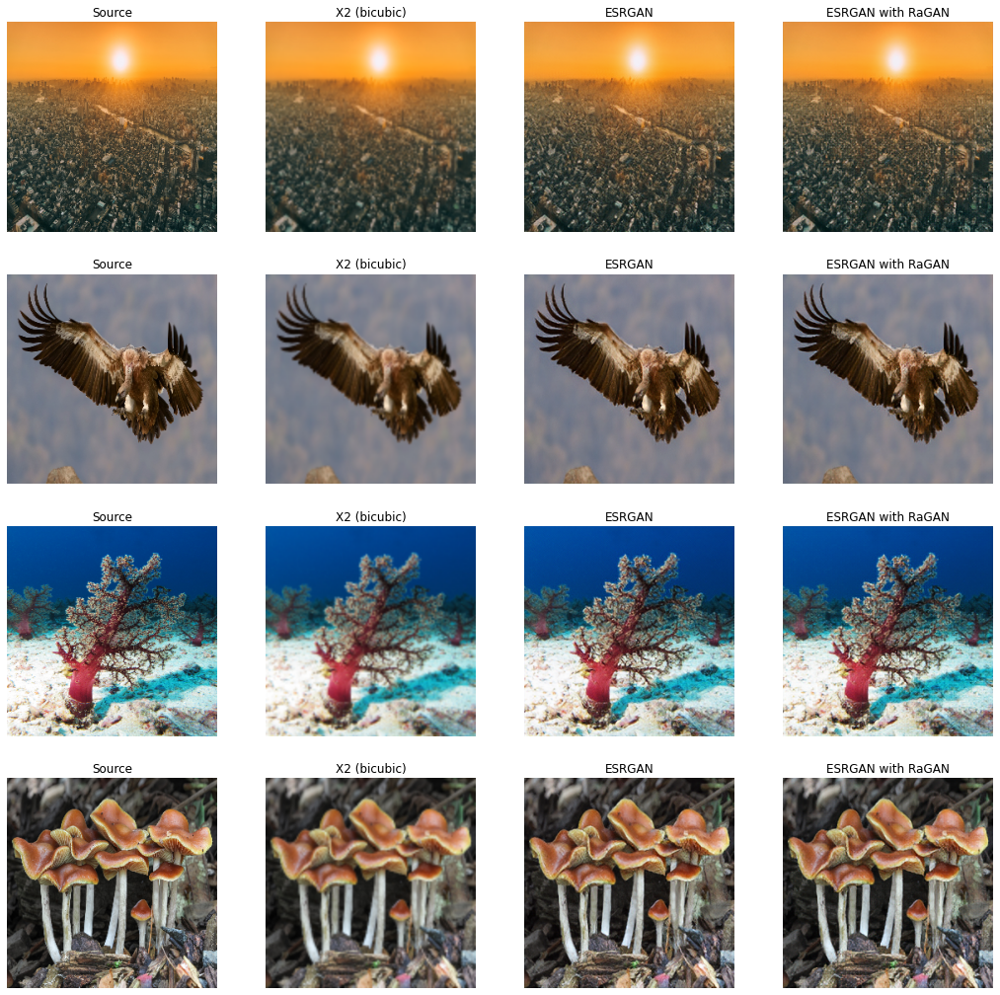

In [32]:
plot_gan_comp(esrgan_G,esrgan_ragan_G,'ESRGAN','ESRGAN with RaGAN')

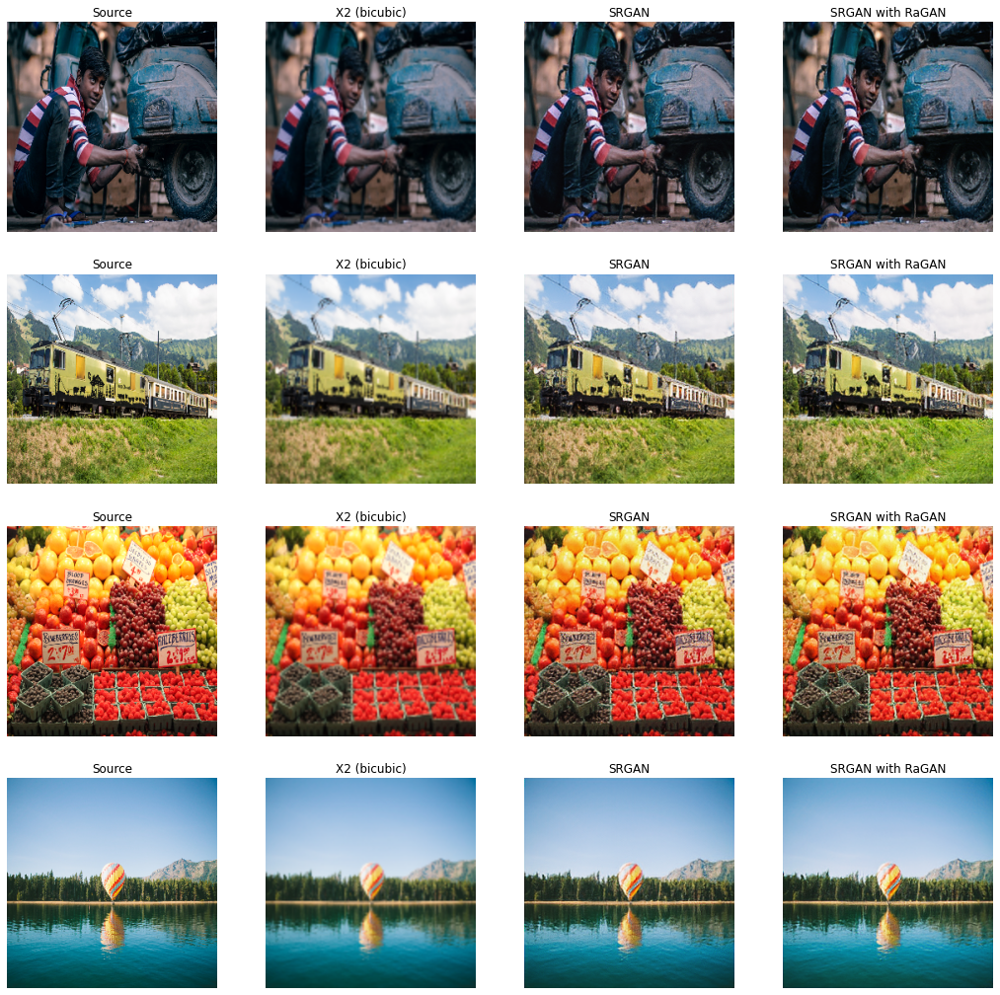

In [33]:
plot_gan_comp(srgan_G,srgan_ragan_G,'SRGAN','SRGAN with RaGAN')

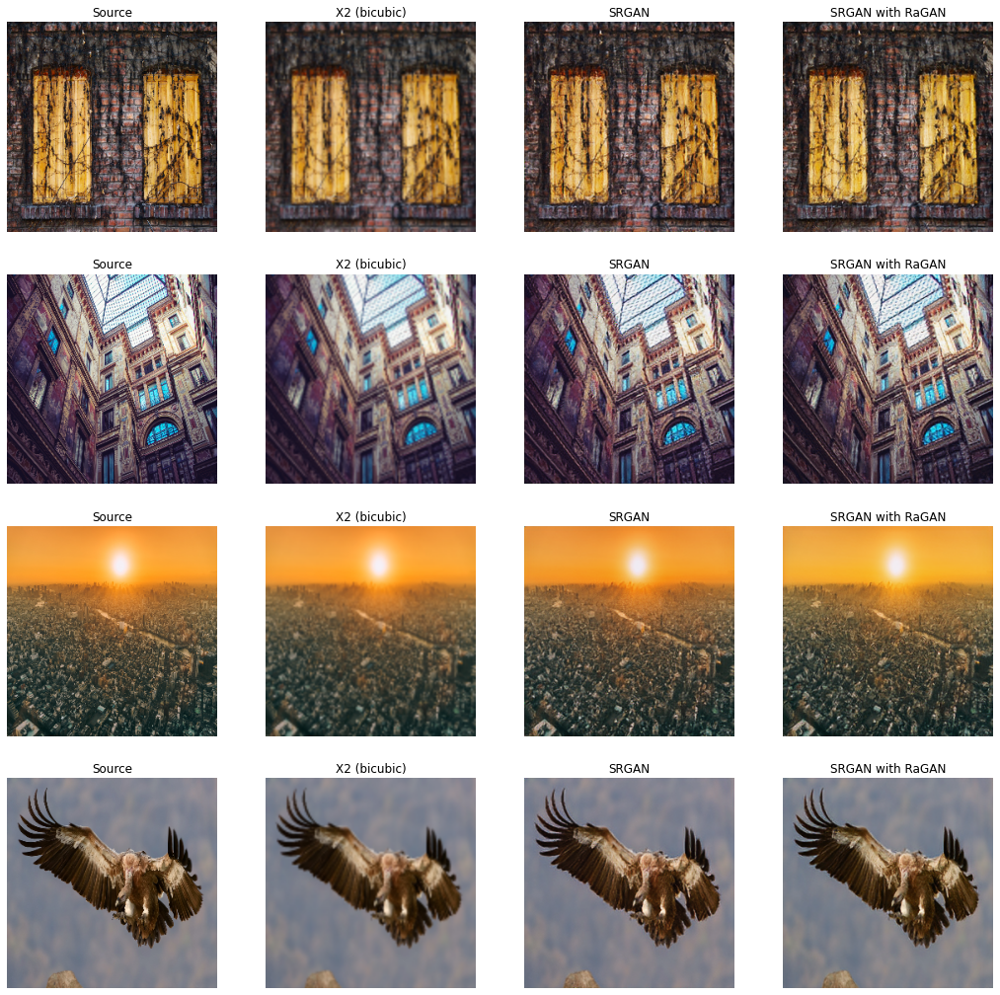

In [34]:
plot_gan_comp(srgan_G,srgan_ragan_G,'SRGAN','SRGAN with RaGAN')

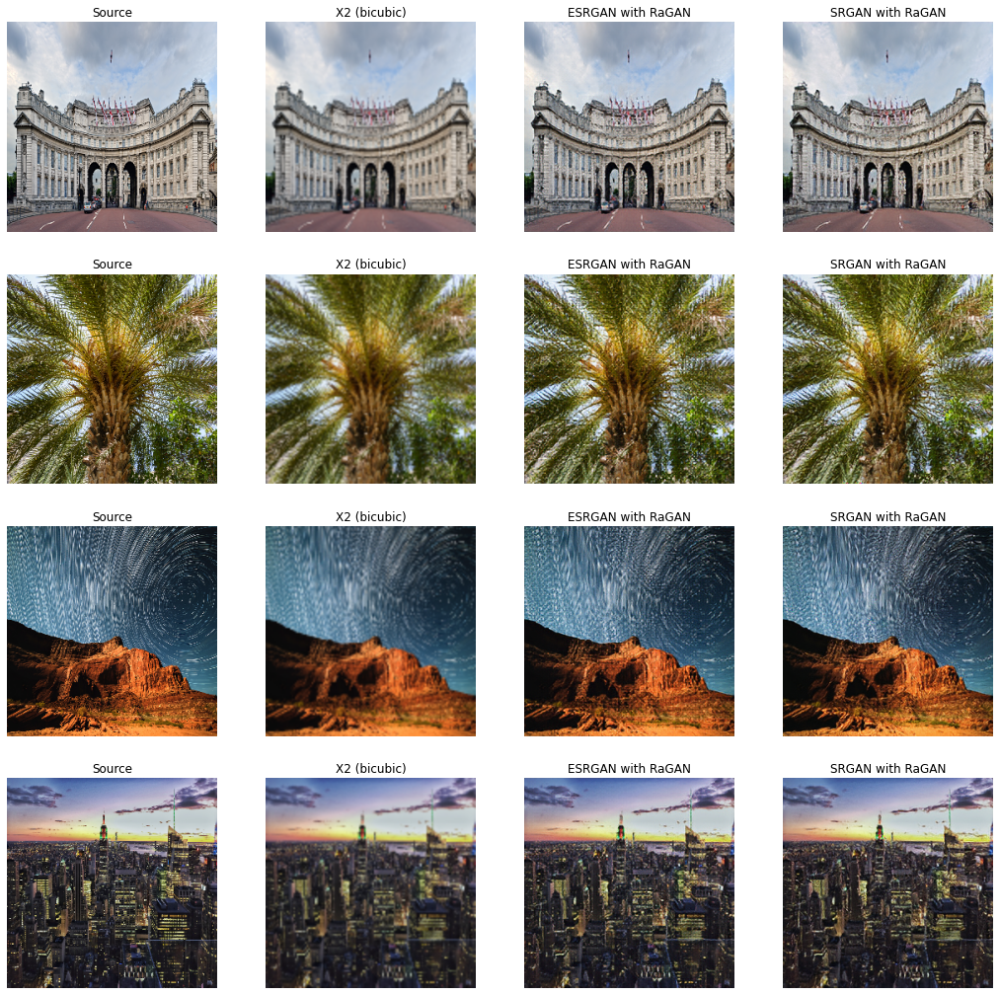

In [35]:
plot_gan_comp(esrgan_ragan_G,srgan_ragan_G,'ESRGAN with RaGAN','SRGAN with RaGAN')

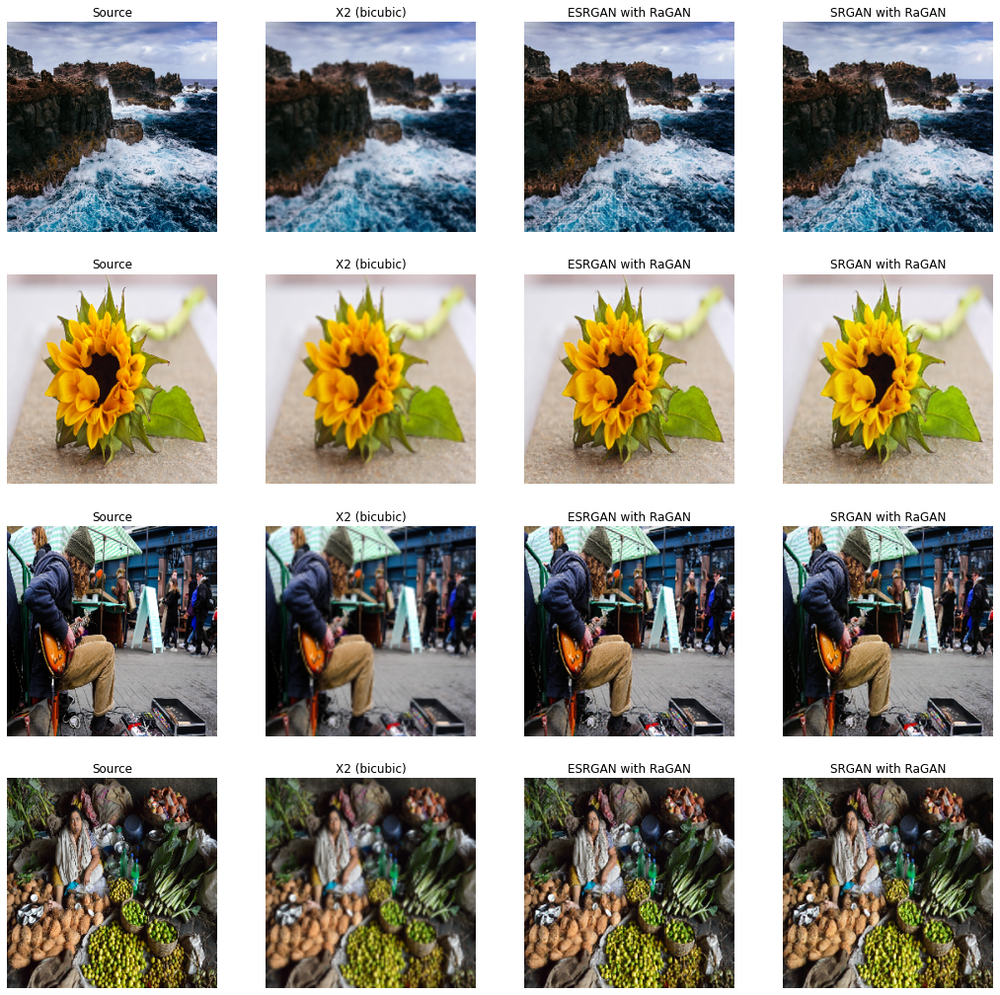

In [36]:
plot_gan_comp(esrgan_ragan_G,srgan_ragan_G,'ESRGAN with RaGAN','SRGAN with RaGAN')

Define function to provide visual comparison by zooming into the GAN results.

In [37]:
def plot_gan_comp_zoom(G1,G2,G1_name,G2_name):
    crop_height = 96
    crop_width = 96
    fig = plt.figure(figsize=(24, 12))
    #fig.set_tight_layout({"pad": .0})
    plt.tight_layout()

    idx = np.random.randint(0, low_reso_imgs.shape[0] - 1)
    img_hrp,x,y = get_random_crop(high_reso_imgs[idx], crop_height, crop_width)

    img_tmp = cv2.resize(low_reso_imgs[idx], (256, 256))

    rect = patches.Rectangle((x,y),crop_height,crop_width,linewidth=1,edgecolor='r',facecolor='none')
    rect1 = patches.Rectangle((x,y),crop_height,crop_width,linewidth=1,edgecolor='r',facecolor='none')
    rect2 = patches.Rectangle((x,y),crop_height,crop_width,linewidth=1,edgecolor='r',facecolor='none')
    rect3 = patches.Rectangle((x,y),crop_height,crop_width,linewidth=1,edgecolor='r',facecolor='none')

    ax1  = fig.add_subplot(2, 4, 1)
    ax1.add_patch(rect)
    plt.imshow(high_reso_imgs[idx])
    plt.grid('off')
    plt.axis('off')
    plt.title('Source')


    ax5  = fig.add_subplot(2, 4, 5)
    plt.imshow(img_hrp)
    plt.grid('off')
    plt.axis('off')
    plt.title('Source')

    ax2  = fig.add_subplot(2, 4, 2)

    plt.imshow(img_tmp)
    ax2.add_patch(rect1)
    plt.grid('off')
    plt.axis('off')
    plt.title('X2 (bicubic)')

    ax6  = fig.add_subplot(2, 4, 6)
    plt.imshow(img_tmp[y: y + crop_height, x: x + crop_width])
    plt.grid('off')
    plt.axis('off')
    plt.title('X2 (bicubic)')

    img = G1.predict(np.expand_dims(low_reso_imgs[idx], axis=0) / 127.5 - 1)
    img_unnorm = (img + 1) * 127.5
    ax3  = fig.add_subplot(2, 4, 3)
    ax3.add_patch(rect2)
    img1 = np.squeeze(img_unnorm, axis=0).astype(np.uint8)
    plt.imshow(img1)
    plt.grid('off')
    plt.axis('off')
    plt.title(G1_name)


    ax7  = fig.add_subplot(2, 4, 7)
    plt.imshow(img1[y: y + crop_height, x: x + crop_width])
    plt.grid('off')
    plt.axis('off')
    plt.title(G1_name)
    
    img = G2.predict(np.expand_dims(low_reso_imgs[idx], axis=0) / 127.5 - 1)
    img_unnorm = (img + 1) * 127.5
    ax4  = fig.add_subplot(2, 4, 4)
    ax4.add_patch(rect3)
    img2 = np.squeeze(img_unnorm, axis=0).astype(np.uint8)
    plt.imshow(img2)
    plt.grid('off')
    plt.axis('off')
    plt.title(G2_name)


    ax8  = fig.add_subplot(2, 4, 8)
    plt.imshow(img2[y: y + crop_height, x: x + crop_width])
    plt.grid('off')
    plt.axis('off')
    plt.title(G2_name)

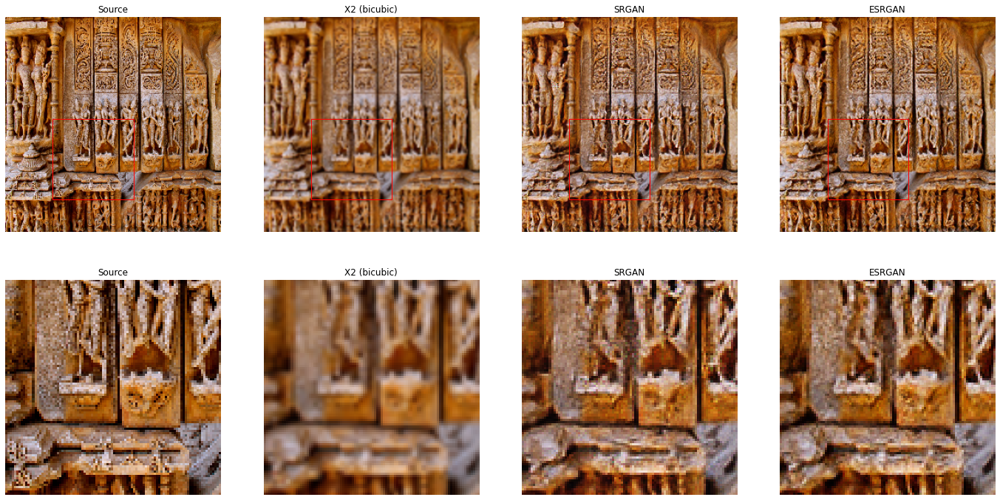

In [38]:
plot_gan_comp_zoom(srgan_G,esrgan_G,'SRGAN','ESRGAN')

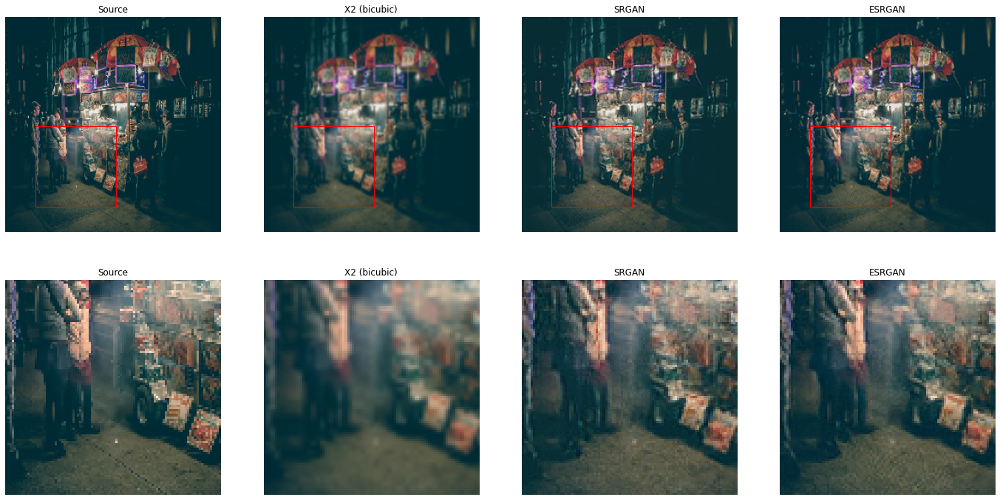

In [39]:
plot_gan_comp_zoom(srgan_G,esrgan_G,'SRGAN','ESRGAN')

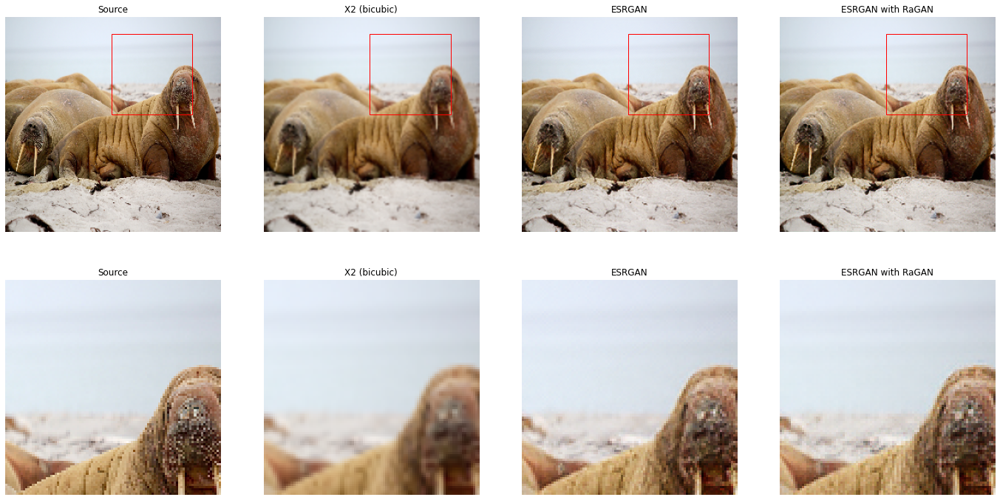

In [40]:
plot_gan_comp_zoom(esrgan_G,esrgan_ragan_G,'ESRGAN','ESRGAN with RaGAN')

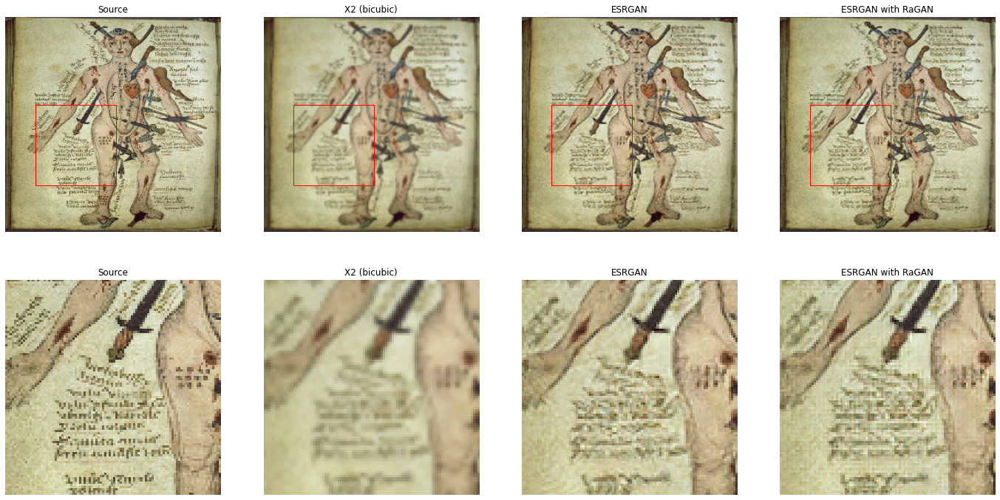

In [41]:
plot_gan_comp_zoom(esrgan_G,esrgan_ragan_G,'ESRGAN','ESRGAN with RaGAN')

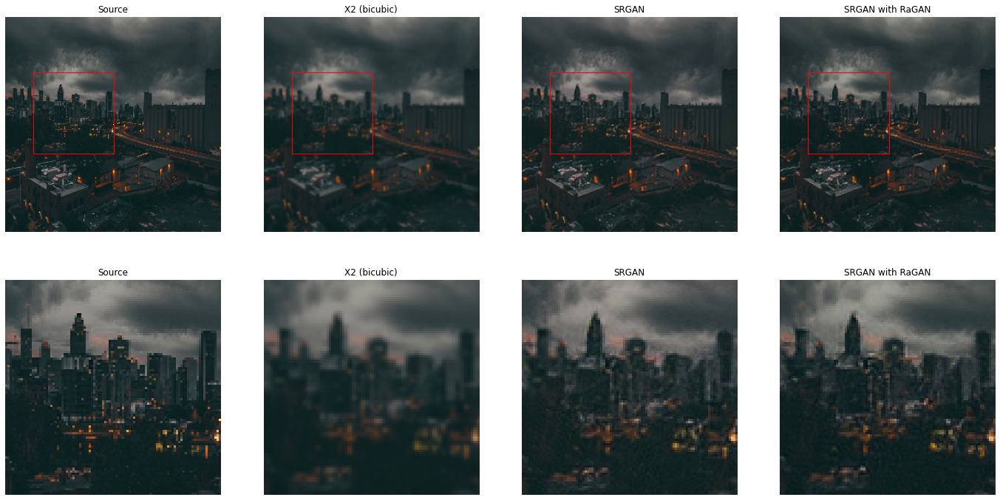

In [42]:
plot_gan_comp_zoom(srgan_G,srgan_ragan_G,'SRGAN','SRGAN with RaGAN')

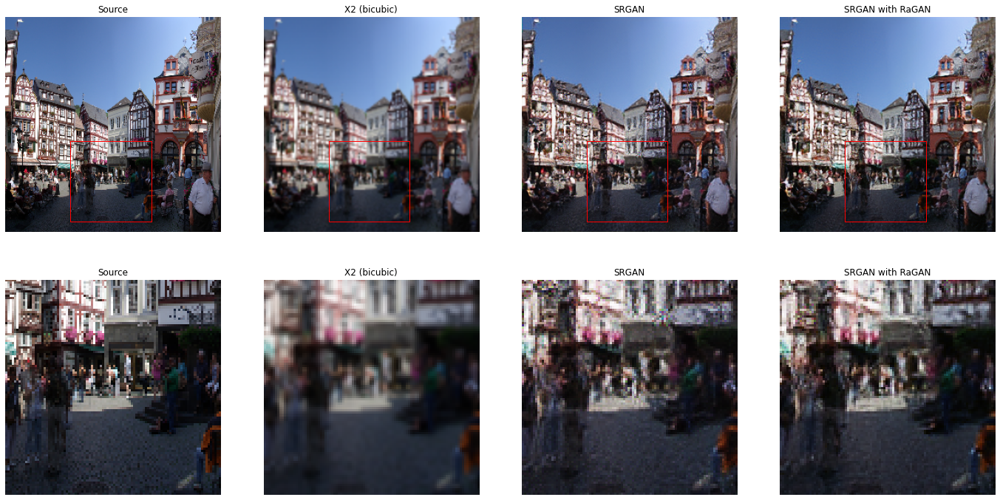

In [43]:
plot_gan_comp_zoom(srgan_G,srgan_ragan_G,'SRGAN','SRGAN with RaGAN')

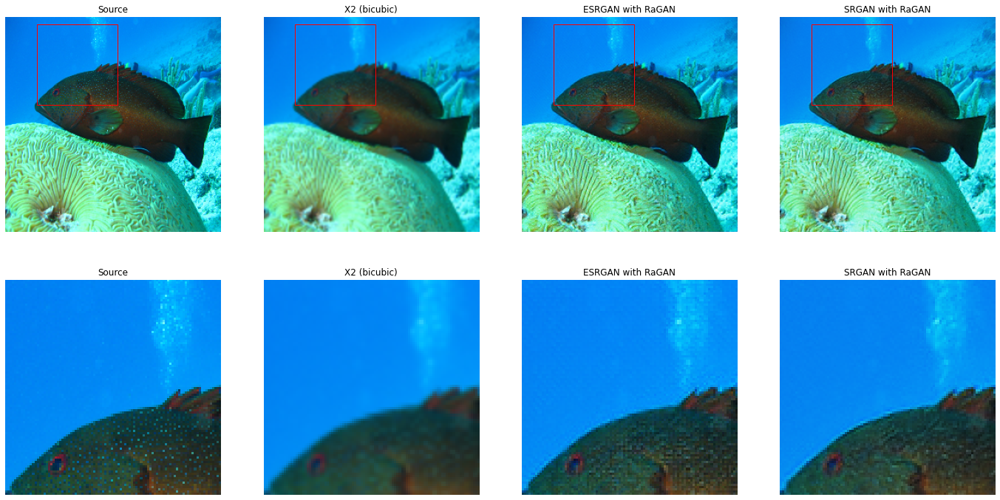

In [44]:
plot_gan_comp_zoom(esrgan_ragan_G,srgan_ragan_G,'ESRGAN with RaGAN','SRGAN with RaGAN')

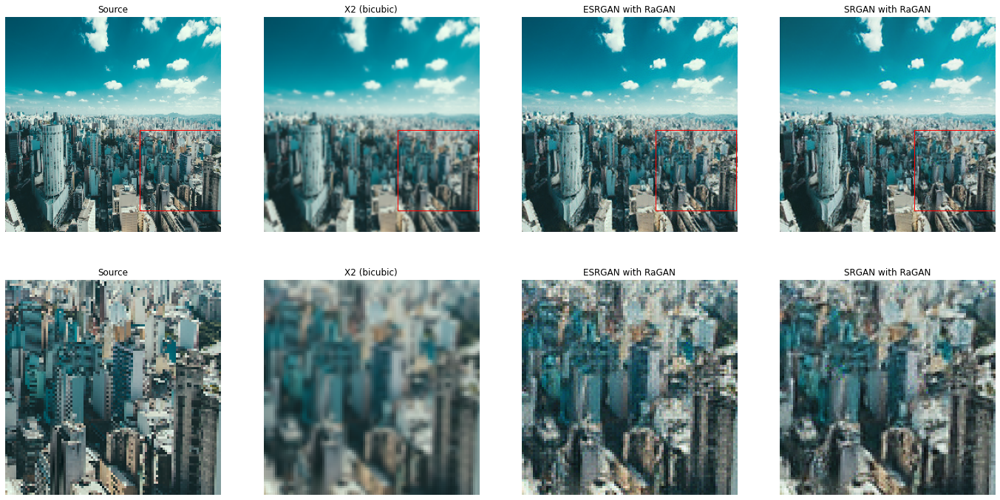

In [45]:
plot_gan_comp_zoom(esrgan_ragan_G,srgan_ragan_G,'ESRGAN with RaGAN','SRGAN with RaGAN')